::: {.callout-note title="Colab Link"}

<center>

[![](images/colab-badge.svg)<br>Click here to **open in Colab**](https://colab.research.google.com/github/jpowerj/dsan5000/blob/main/writeups/clustering/DSAN5000_Clustering_Lab.ipynb?authuser=1){target="_blank"}

</center>

:::

## (1) Introduction

### (1.1) Overview

In this lab, we're going to explore how different clustering methods work in different EDA contexts: recall how, in lecture, we were able to evaluate whether or not a given clustering of points was a "good" clustering because we **knew** the underlying **Data Generating Process**.

As mentioned in lecture, when we explore clustering in this way it's a bit like riding a bike with training wheels: if we are in doubt about whether the clusters are "good" or "bad", we can simply compare them to the **true** underlying clusters that were used to generate the data:

![](https://jjacobs.me/dsan5000/463a01339cf0f456ba54a1849df50d1a22c247e3/w09/index_files/figure-revealjs/plot-gaussian-mixture-mle-1.png)

Here we know that our estimated clusters (the green points and the yellow points) are "good" because, for all but one data point (the point labeled with an "X" rather than a circle), the estimated clusters match the true clusters.

In this lab, however, we are going to start moving away from this "training wheels" mode: we'll start in Part 1 by taking off the training wheels but restricting ourselves to **binary clustering** (asking the computer to separate the data into just two clusters), seeing what **underlying information** about the reviews is "discovered" by these unsupervised clustering algorithms.

Then, in Part 2, we will "trust" whatever clustering method we liked best from Part 1 and use it to **discover** new things in our dataset, in an EDA mode.

### (1.2) The Dataset: RateMyProfessors.com Reviews

For this lab I've compiled every review ever written for <a href='https://www.ratemyprofessors.com/school/355' target='_blank'>Georgetown professors</a> on <a href='https://www.ratemyprofessors.com' target='_blank'>RateMyProfessors.com</a>.

The idea here is that, whereas in the example we did in class we **generated** the data explicitly on the basis of some data-generating process (two Gaussian clusters, in the example plotted above), here we **do not have control over** the data-generating process: we simply observe the reviews as they are given to us.

**However**, the reason this first part is still "easy mode" in a sense is because, sociologically, we actually **do** know something about the data generating process which produces these reviews: as has been documented in several studies (using a wide variety of data sources, not just RateMyProfessors!), student evaluations of professors exhibit quite strong <a href='https://www.science.org/content/article/teaching-evaluations-reflect-and-may-perpetuate-academia-s-gender-biases' target='_blank'>**linguistic biases**</a> related to the **gender** of the professor being evaluated. Long story short, the biases which emerge from these studies are things like:

* Female professors are judged on their appearance more often than male professors,
* Female professors are described as "bossy", "pushy", or "stern" more often than male professors, even when we account for (e.g.) the average grades given by the professors, and
* Female professors are accused more often than male professors of being "unfair", "harsh", "cruel", etc. when assigning grades, again even when we control for the average grades given out by the professors being evaluated.

For more information on these biases, you can check out:

* <a href='https://link.springer.com/article/10.1007/s10755-014-9313-4' target='_blank'>MacNell, Driscoll, and Hunt (2014), "What's in a Name: Exposing Gender Bias in Student Ratings of Teaching"</a>: One of the papers which first brought attention to this issue, since it carefully isolated the independent and dependent variables by **randomly varying** the expressed gender identities of teachers in an **online course** (so that this gender expression was the **only** signal that students had of a teacher's gender):

  > <i>While difficult to separate gender from teaching practices in person, it is possible to disguise an instructor's gender identity online. In our experiment, assistant instructors in an online class each operated under **two different gender identities**. Students rated the **male** identity significantly higher than the **female** identity, **regardless of the instructor's actual gender**.</i>

* Benjamin Schmidt's <a href='https://benschmidt.org/profGender/' target='_blank'>visualization of gendered language in evaluations</a>, which took the controlled experiment of MacNell, Driscoll, and Hunt and extended their ideas to a **text-analytic** study of **all** reviews on RateMyProfessors.com
* <a href='https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0216241' target='_blank'>Peterson et al. (2019), "Mitigating Gender Bias in Student Evaluations of Teaching"</a>, which describes how the language of the **review forms themselves** can be modified to intentionally "nudge" students towards focusing on non-gendered aspects of their experiences a course.

So, even though we will now be running clustering algorithms **without** providing these algorithms with **any information** on the gender of the professors being reviewed, we will quickly see that the dimension of gender essentially **"overrides" all other signals** present in the textual reviews, leading our clustering algorithms to detect this gender information over and above any other pattern which exists in the dataset!

*(This is why, after checking the results in this section, in the next section we will attempt to **remove** all gender information from the reviews, to try and detect what other **non-gender-based** patterns may exist in the reviews)*

### (1.3) Loading the Data

The data for this lab comes in the form of **two files**:

1. `georgetown_profs.csv` contains one row per **professor**, and contains the following information for each one:

| Variable | Description |
| - | - |
| `teacher_id` | A unique (integer) id for the teacher |
| `avgDifficulty` | The average **difficulty score** given to the teacher, across all of their reviews |
| `avgRating` | The average **overall rating** given to the teacher, across all of their reviews |
| `department` | The department (within Georgetown) in which the professor teaches |
| `firstName` | The professor's first (given) name |
| `lastName` | The professor's last (family) name |
| `numRatings` | The total number of ratings which have been submitted for this professor |
| `wouldTakeAgainPercent` | The percent of all reviewers who stated that they **would** take a class with the same professor again |
| `gender` | The **inferred gender** of the professor* |
| `gender_count` | The number of datapoints used to infer this professor's gender identity* |
| `gender_prob` | The **confidence level** (scaled to range from 0 to 1) for the inferred gender of this professor* |

<sup>*</sup> Note that, for the gender inference, I used the <a href='https://genderize.io/' target='_blank'>Genderize.io API</a>, which contains much more documentation on how gender is inferred than I can provide here. But, rather than thinking of gender here as some inherent property of the individual, just understand that it represents **the most-frequently-reported gender identity** of individuals from a **large dataset** of self-reported genders: `gender_count` is the number of individuals with the same name as the professor in this self-reported-gender dataset, and `gender_prob` is the **proportion** of these `gender_count` individuals who reported the inferred gender.

For example, if the survey used by Genderize.io had **100 people** with the name "Chris", and 60% of them self-reported their gender as "male" while 30% self-reported their gender as "female" (with 10% thus self-reporting their gender as a value besides "male" or "female"), then professors with the first name Chris would have `gender` inferred to be "male", with a `gender_count` value of 100 and a `gender_prob` value of 0.6.

2. `georgetown_reviews.csv` contains one row per **review**, and contains the following information for each one:

| Variable | Description |
| - | - |
| `teacher_id` | The unique (integer) id for the teacher being evaluated (thus allowing us to merge the reviews back into the `georgetown_profs.csv` data, if we need to) |
| `gender` | The inferred gender of the teacher being evaluated, as described above |
| `comment` | The full text of the review |
| `rating` | The **overall** numerical rating given to the teacher by the reviewer |

In [1]:
import pandas as pd
import numpy as np

In [2]:
# Professor metadata
prof_data_url = "https://jpj.georgetown.domains/dsan5000-scratch/clustering/georgetown_profs.csv"
prof_df = pd.read_csv(prof_data_url)
prof_df.shape

(2157, 12)

In [3]:
prof_df.head()

,teacher_id,avgDifficulty,avgRating,department,firstName,lastName,numRatings,wouldTakeAgainPercent,gender_data,gender_count,gender,gender_prob
0,0,3.7,4.2,English,Kelley,Wickham-Crowley,16,60.0,female,2939.0,female,0.92
1,1,2.8,3.0,Business,Elaine,Romanelli,5,100.0,female,204632.0,female,1.00
2,2,3.8,4.9,Business,Paul,Almeida,23,-1.0,male,1200479.0,male,1.00
3,3,2.6,4.6,Business,Ilkka,Ronkainen,42,-1.0,male,735.0,male,1.00
4,4,3.6,4.1,International Politics,Charles,Pirtle,27,100.0,male,487939.0,male,1.00


In [4]:
# The reviews corpus
text_data_url = "https://jpj.georgetown.domains/dsan5000-scratch/clustering/georgetown_reviews.csv"
reviews_df = pd.read_csv(text_data_url)
reviews_df.shape

(29796, 4)

In [5]:
reviews_df.head()

,teacher_id,gender,comment,rating
0,0,female,I took two classes with Wickham-Crowley this p...,5
1,0,female,Took her for Lit 1. Really really terribly org...,2
2,0,female,Professor Wickham-Crowley is great! She's real...,5
3,0,female,She teaches Lit His I frequently and while she...,3
4,0,female,Prof wickham-Crowley is awesome. Lots of readi...,5


In [6]:
# Drop rows with unknown gender
prof_df = prof_df[prof_df['gender'] != 'unknown'].copy()
reviews_df = reviews_df[reviews_df['gender'] != 'unknown'].copy()

In [7]:
reviews_df.shape

(29579, 4)

Here we do some checks to make sure:

(a) All of the values in the `comment` column are of `str` type:

In [8]:
review_types = reviews_df['comment'].apply(type)
review_types[review_types != str]

Series([], Name: comment, dtype: object)

and

(b) All of the string values in the `comment` column are non-empty:

In [9]:
reviews_df[reviews_df['comment'].str.len() == 0]

,teacher_id,gender,comment,rating


## (2) Basic EDA

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()
sns.set_style('whitegrid')

### (2.1) Professor-Level (Aggregated/Average) Data

In [11]:
gender_means = prof_df.groupby('gender')['avgRating'].mean()
gender_means

gender
female    3.961609
male      3.862919
Name: avgRating, dtype: float64

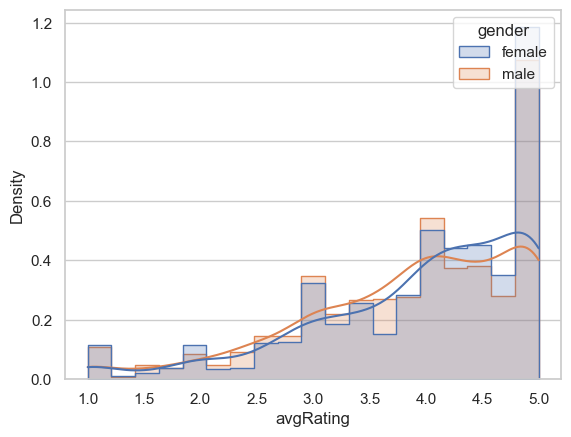

In [12]:
rating_plot = sns.histplot(data=prof_df, x='avgRating', hue='gender', kde=True,
                           stat='density', element='step', common_norm=False)
rating_plot.xaxis.grid(False)

### (2.2) Review-Level (Non-Aggregated) Data

In [13]:
reviews_df.groupby('gender')['rating'].mean()

gender
female    3.844205
male      3.791452
Name: rating, dtype: float64

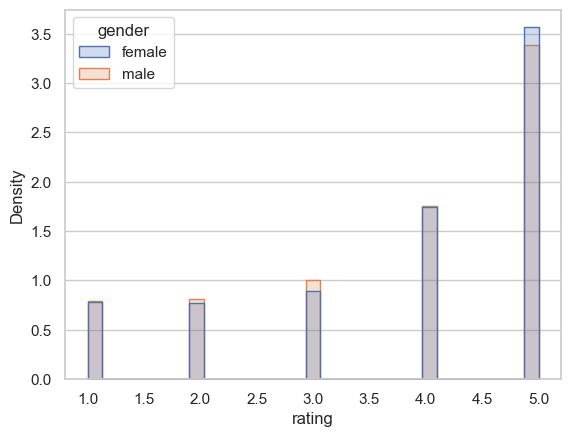

In [14]:
review_plot = sns.histplot(data=reviews_df, x='rating', hue='gender', kde=False,
                           stat='density', element='step', common_norm=False)
sns.move_legend(review_plot, 'upper left')
review_plot.xaxis.grid(False)

### (2.3) Text Preprocessing

In [15]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /Users/jpj/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /Users/jpj/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [16]:
from nltk.tokenize import sent_tokenize, word_tokenize
# Note that we *don't* want to remove the full stopwords list here, since it will remove
# gendered pronouns like "she" and "he"!
from nltk.stem.wordnet import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()

In [17]:
custom_stopwords = [
    'a', 'about', 'all', 'also', 'an', 'and', 'are', 'as', 'at',
    'be', 'both', 'but', 'by',
    'can',
    'do',
    'for', 'from',
    'get', 'go',
    'had', 'have',
    'i', 'if', 'in', 'is', 'it',
    'me', 'more', 'my',
    'no', 'not',
    'of', 'on', 'one', 'or', 'out',
    'should', "should've", 'so',
    'take', 'than', 'that', 'the', 'this', 'to', 'too',
    'up',
    'very',
    'want', 'was', 'we', 'were', 'what', 'where', 'which', 'with', 'would', "would've",
    'you', 'your',
]

custom_stoplemmas = [
    'be',
    'ir',
    'll',
    'nt',
    'quot',
    'rd',
    's',
    've'
]

In [18]:
from tqdm import tqdm
tqdm.pandas()

In [19]:
# Text preprocessing
import string
from collections import Counter
token_counter = Counter()

def remove_special_chars(token):
  return token.translate(str.maketrans('', '', string.punctuation))

def remove_digits(token):
  return ''.join([c for c in token if not c.isdigit()])

def clean_review(review_text):
  review_cleaned = review_text.lower()
  # Sentence segmentation
  review_sents = sent_tokenize(review_cleaned)
  clean_sents = []
  # Tokenize each sentence
  for cur_sent in review_sents:
    sent_tokens = word_tokenize(cur_sent)
    # Remove stopwords
    sent_tokens_cleaned = [t for t in sent_tokens if t not in custom_stopwords]
    # Remove digits from each token
    sent_tokens_cleaned = [remove_digits(t) for t in sent_tokens_cleaned]
    # Replace hyphens in hyphenated words with spaces
    sent_tokens_cleaned = [t.replace("-", " ") for t in sent_tokens_cleaned]
    # Remove special characters (punctuation)
    sent_tokens_cleaned = [remove_special_chars(t) for t in sent_tokens_cleaned]
    # Make sure empty tokens are removed
    sent_tokens_cleaned = [t for t in sent_tokens_cleaned if len(t) > 0]
    # Lemmatize
    sent_tokens_cleaned = [lemmatizer.lemmatize(t) for t in sent_tokens_cleaned]
    # And then we remove custom_stoplemmas
    sent_tokens_cleaned = [t for t in sent_tokens_cleaned if t not in custom_stoplemmas]
    # Add to our Counter object
    token_counter.update(sent_tokens_cleaned)
    # Re-join the individual tokens in the sentence into a single string
    clean_sent = ' '.join(sent_tokens_cleaned)
    clean_sents.append(clean_sent)
  # And now re-join the individual (cleaned) sentences into a single string
  review_final = ". ".join(clean_sents)
  return review_final
reviews_df['comment_clean'] = reviews_df['comment'].progress_apply(clean_review)

100%|██████████| 29579/29579 [00:09<00:00, 3182.93it/s]


In [20]:
reviews_df.head()

,teacher_id,gender,comment,rating,comment_clean
0,0,female,I took two classes with Wickham-Crowley this p...,5,took two class wickham crowley past semester. ...
1,0,female,Took her for Lit 1. Really really terribly org...,2,took her lit really really terribly organised ...
2,0,female,Professor Wickham-Crowley is great! She's real...,5,professor wickham crowley great. she really ni...
3,0,female,She teaches Lit His I frequently and while she...,3,she teach lit his frequently while she really ...
4,0,female,Prof wickham-Crowley is awesome. Lots of readi...,5,prof wickham crowley awesome. lot reading give...


And here, as a (rough) check to see whether our custom stopwords list indeed removed the non-informative words for our context, we print out the 50 most common words across the entire corpus:

In [21]:
token_counter.most_common(25)

[('class', 29284),
 ('he', 19709),
 ('she', 15214),
 ('professor', 11784),
 ('his', 9710),
 ('her', 9682),
 ('lecture', 7984),
 ('really', 7700),
 ('reading', 6025),
 ('great', 6017),
 ('student', 5929),
 ('lot', 5681),
 ('easy', 5313),
 ('interesting', 5225),
 ('paper', 5098),
 ('make', 4841),
 ('good', 4766),
 ('grade', 4622),
 ('will', 4615),
 ('test', 4264),
 ('prof', 4188),
 ('work', 3802),
 ('hard', 3697),
 ('final', 3619),
 ('him', 3593)]

### (2.4) Vectorization

In [22]:
from sklearn.feature_extraction.text import CountVectorizer

In [23]:
corpus = reviews_df['comment_clean'].values

Note here that, for the sake of speed, we are eliminating a **lot** of words: we are only keeping words which appear in at least **5 different reviews** (by setting `min_df=5`), and we are dropping words which are so common that they appear in **40% or more** of all the reviews

In [24]:
max_document_freq = 0.4
min_document_count = 6

In [25]:
cv = CountVectorizer(max_df=max_document_freq, min_df=min_document_count)

In [26]:
X = cv.fit_transform(corpus)

In [27]:
X.shape

(29579, 5159)

In [28]:
feature_names = cv.get_feature_names_out()
feature_names

array(['aa', 'ab', 'abi', ..., 'zimmer', 'zone', 'zoom'], dtype=object)

Here we're also going to make a version with **gendered** words cut out, for later usage (the suffix `_ng` will represent the no-gender versions of each of the original variables)

In [29]:
gender_tokens = [
    'he', 'him', 'his', 'guy', 'man',
    'she', 'her', 'hers', 'girl', 'woman',
]

In [30]:
cv_ng = CountVectorizer(max_df=max_document_freq, min_df=min_document_count,
                              stop_words=gender_tokens)
X_ng = cv_ng.fit_transform(corpus)
X_ng.shape

(29579, 5149)

In [31]:
feature_names_ng = cv_ng.get_feature_names_out()

## (3) Finding the Most Prominent "Signal" via Clustering

In this part of the lab, the "training wheels" part, we will have a **known** desired clustering: in this case, we will take our teacher reviews, ask the computer to cluster them **without** giving it any information on the gender of the professor being reviewed, and see whether it "discovers" the gender split or some other way of splitting the data!

In [32]:
from sklearn.cluster import KMeans

In [33]:
kmeans = KMeans(init="random", n_clusters=2, n_init=4, random_state=5000)

In [34]:
kmeans.fit(X)

KMeans(init='random', n_clusters=2, n_init=4, random_state=5000)

In [35]:
y_pred = kmeans.predict(X)

In [36]:
y_pred

array([0, 1, 1, ..., 0, 1, 0], dtype=int32)

In [37]:
len(y_pred[y_pred==0])

22944

In [38]:
len(y_pred[y_pred==1])

6635

So, how can we check what our clusters have picked up about each review? One good start could be: let's find the two centroids, then for each one find the point in our dataset closest to the centroid. These will be, in a sense, the "most representative" points within each cluster.

In [39]:
centroids = kmeans.cluster_centers_

https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise_distances_argmin_min.html

In [40]:
from sklearn.metrics import pairwise_distances_argmin_min

In [41]:
centroids.shape

(2, 5159)

In [42]:
argmins, mins = pairwise_distances_argmin_min(centroids, X)

In [43]:
argmins, mins

(array([  579, 11623]), array([1.24893915, 1.90244   ]))

In [44]:
argmin_0 = argmins[0]
y_pred[argmin_0]

0

In [45]:
reviews_df.iloc[argmin_0]['comment']

"he's a damned flake"

In [46]:
argmin_1 = argmins[1]
y_pred[argmin_1]

1

In [47]:
reviews_df.iloc[argmin_1]['comment']

'She is a great professor. Take her class.'

These two representative reviews are actually pretty good indicators of the **signal** (gender) that our unsupervised clustering algorithm seems to be picking up!

Now let's take our full reviews corpus, split it into two subcorpora based on the unsupervised clusters, and see if gender is indeed what it's picking up.

In [48]:
reviews_df['y_pred'] = y_pred

In [49]:
reviews_df.head()

,teacher_id,gender,comment,rating,comment_clean,y_pred
0,0,female,I took two classes with Wickham-Crowley this p...,5,took two class wickham crowley past semester. ...,0
1,0,female,Took her for Lit 1. Really really terribly org...,2,took her lit really really terribly organised ...,1
2,0,female,Professor Wickham-Crowley is great! She's real...,5,professor wickham crowley great. she really ni...,1
3,0,female,She teaches Lit His I frequently and while she...,3,she teach lit his frequently while she really ...,1
4,0,female,Prof wickham-Crowley is awesome. Lots of readi...,5,prof wickham crowley awesome. lot reading give...,0


In [50]:
pd.crosstab(reviews_df['gender'], reviews_df['y_pred'])

y_pred,0,1
gender,,
female,4922,6330
male,17987,287


And indeed, we see that our clustering algorithm has essentially produced a "gender detector" (though, more specifically, a **male** gender detector): if the professor being reviewed is male, the algorithm will almost always assign the review to Cluster 1. Then (albeit with much less precision), if the professor being reviewed is female, the algorithm will usually assign the review to Cluster 0.

We don't need to rely on the raw counts in the above table to make these inferences, moreover: we can use additional arguments to the `pd.crosstab()` function to observe the **probability distributions** induced by our clustering:

The **overall joint distribution** looks as follows:

In [51]:
pd.crosstab(reviews_df['gender'], reviews_df['y_pred'], normalize='all', margins=True)

y_pred,0,1,All
gender,,,
female,0.166701,0.214387,0.381088
male,0.609192,0.009720,0.618912
All,0.775892,0.224108,1.000000


Which tells us, for example, that:

* About 21.4% of all the reviews were reviews of **female** professors placed into **Cluster 0** (based on the value in row `female`, column `0`)
* About 61.9% of all the reviews were of **male** professors (based on the value in row `male`, column `All`), and
* About 77.6% of all the reviews were placed into **Cluster 1** (based on the value in row `All`, column `1`).

More informative for our purposes, however, are the **conditional distributions** shown in the following tables:

First, the distribution of **cluster assignments** for each **gender**, that is, $\Pr(\text{Gender} = g \mid \text{Cluster} = c)$:

In [52]:
pd.crosstab(reviews_df['gender'], reviews_df['y_pred'], normalize='columns')

y_pred,0,1
gender,,
female,0.21485,0.956627
male,0.78515,0.043373


This table tells us, for example:

* The probability that a review in Cluster 0 is a review of a **female** professor is about 95.7% (based on the value in row `female` column `0`),
* The probability that a review in Cluster 1 is a review of a **male** professor is about 78.5% (based on the value in row `male` column `1`)

Then we can reverse the order of our conditioning, to obtain the distribution of **cluster assignments** conditional on **gender**, that is $\Pr(\text{Cluster} = c \mid \text{Gender} = g)$:

In [53]:
pd.crosstab(reviews_df['gender'], reviews_df['y_pred'], normalize='index')

y_pred,0,1
gender,,
female,0.437433,0.562567
male,0.984295,0.015705


This table tells us, for example:

* The probability that a review for a **male** professor was placed in **Cluster 1** is about 98.4% (based on the value in row `male` column `1`)
* The probability that a review for a **female** professor was placed in **Cluster 0** is about 56.3% (based on the value in row `female` column `0`)

So, now that we've seen how a totally unsupervised clustering method---a method which was created to cluster **numeric** data---constructs a clustering of this textual dataset, let's now consider an alternative clustering method that was created specifically to cluster **text** data: Non-Negative Matrix Factorization.

## (4) Clustering as Dimensionality Reduction: Textual Topic Models

In [54]:
X.shape

(29579, 5159)

Since the course has a whole unit on **dimensionality reduction**, so that you can dive into that material to really understand the details, here I'll just lay out the general format of what **Non-Negative Matrix Factorization** (shortened to `NMF` in scikit-learn, and from here onwards in the text) produces when given a full **document-term matrix** like our `X` matrix above.

Mathematically, NMF **factors** the document-term matrix $\mathbf{X}$ into two matrices $\mathbf{W}$ and $\mathbf{H}$, so that $\mathbf{X} = \mathbf{W}\mathbf{H}$, where $\mathbf{W}$ stands for **"weights"** and $\mathbf{H}$ stands for **"hidden values"**.

So, if a corpus has $D$ documents and $V$ terms in its **vocabulary** (that is, there are $V$ unique tokens across the corpus), then estimating an NMF model on this corpus with $K$ desired topics corresponds to performing the following matrix factorization of $\mathbf{X}$ (where $f_{i,j}$ represents the frequency of token $j$ in document $i$):

$$
\underbrace{
\begin{bmatrix}
f_{1,1} & f_{1,2} & \cdots & f_{1,V} \\
f_{2,1} & f_{2,2} & \cdots & f_{2,V} \\
\vdots & \vdots & \ddots & \vdots \\
f_{D,1} & f_{D,2} & \vdots & f_{d,V}
\end{bmatrix}
}_{\mathbf{X}_{[D \times V]}} = \underbrace{
\begin{bmatrix}
w_{1,1} & w_{1,2} & \cdots & w_{1,K} \\
w_{2,1} & w_{2,2} & \cdots & w_{2,K} \\
\vdots & \vdots & \ddots & \vdots \\
w_{D,1} & w_{D,2} & \cdots & w_{D,K}
\end{bmatrix}
}_{\mathbf{W}_{[D \times K]}}
\underbrace{
\begin{bmatrix}
h_{1,1} & h_{1,2} & \cdots & h_{1,V} \\
h_{2,1} & h_{2,2} & \cdots & h_{2,V} \\
\vdots & \vdots & \ddots & \vdots \\
h_{K, 1} & h_{K,2} & \cdots & h_{K,V}
\end{bmatrix}
}_{\mathbf{H}_{[K \times V]}}
$$

For intuition, it may be easier to visualize this factorization by considering specific values. Let's consider a toy example where we only have $D = 3$ documents and $V = 5$ terms, and we're hoping to infer $K = 2$ topics from this corpus.

Then our document-term matrix $\mathbf{X}$ has 3 rows and 5 columns, and the factorization performed by NMF looks as follows:

$$
\underbrace{
\begin{bmatrix}
f_{1,1} & f_{1,2} & f_{1,3} & f_{1,4} & f_{1,5} \\
f_{2,1} & f_{2,2} & f_{2,3} & f_{2,4} & f_{2,5} \\
f_{3,1} & f_{3,2} & f_{3,3} & f_{3,4} & f_{3,5}
\end{bmatrix}
}_{\mathbf{X}_{[3 \times 5]}} = \underbrace{
\begin{bmatrix}
w_{1,1} & w_{1,2} \\
w_{2,1} & w_{2,2} \\
w_{3,1} & w_{3,2}
\end{bmatrix}
}_{\mathbf{W}_{[3 \times 2]}}
\underbrace{
\begin{bmatrix}
h_{1,1} & h_{1,2} & h_{1,3} & h_{1,4} & h_{1,5} \\
h_{2,1} & h_{2,2} & h_{2,3} & h_{2,4} & h_{2,5}
\end{bmatrix}
}_{\mathbf{H}_{[2 \times 5]}}
$$

And, from one of these two visualizations, we can see how to **use** one of the two matrices (either $\mathbf{W}$ or $\mathbf{H}$) to obtain information about our inferred topics:

* If we want information about the topics estimated for a **document** $i$, we can extract the **$i$th row** of $\mathbf{W}$:
  * This row will have $K$ values in it, such that the $k$th entry in the row will represent (roughly) the **degree to which document $i$ is about topic $k$**.
* If we want information about the topics estimated for a **word** $j$, we can extract the **$j$th column** of $\mathbf{H}$:
  * This column will have $K$ values in it, such that the $k$th entry in the column will represent (roughly) the **degree to which the word $j$ is relevant to the topic $k$**.

In our case, since our original DTM $X$ has 29579 rows and 5159 columns, and we're aiming to estimate $K = 6$ topics within this corpus, we will obtain a factorization $\mathbf{X}_{[29579 \times 5159]} = \mathbf{W}_{[29579 \times 6]}\mathbf{H}_{[6 \times 5159]}$.

### (4.1) Including Gender Terms

To start off, we'll perform NMF-based clustering on exactly the same data as before: the document-term matrix `X` (the full version, with gendered pronouns still included).

In [55]:
import matplotlib.pyplot as plt
from sklearn.decomposition import LatentDirichletAllocation, NMF

In [56]:
def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(2, 3, figsize=(30, 15)) #, sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[-n_top_words:]
        top_features = feature_names[top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f"Topic {topic_idx + 1}", fontdict={"fontsize": 30})
        ax.tick_params(axis="both", which="major", labelsize=20)
        for i in "top right left".split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.show()

In [57]:
n_top_words = 20
num_topics = 6

In [58]:
nmf = NMF(
    n_components=num_topics,
    random_state=5000,
    beta_loss="frobenius",
)
nmf.fit(X)

NMF(n_components=6, random_state=5000)

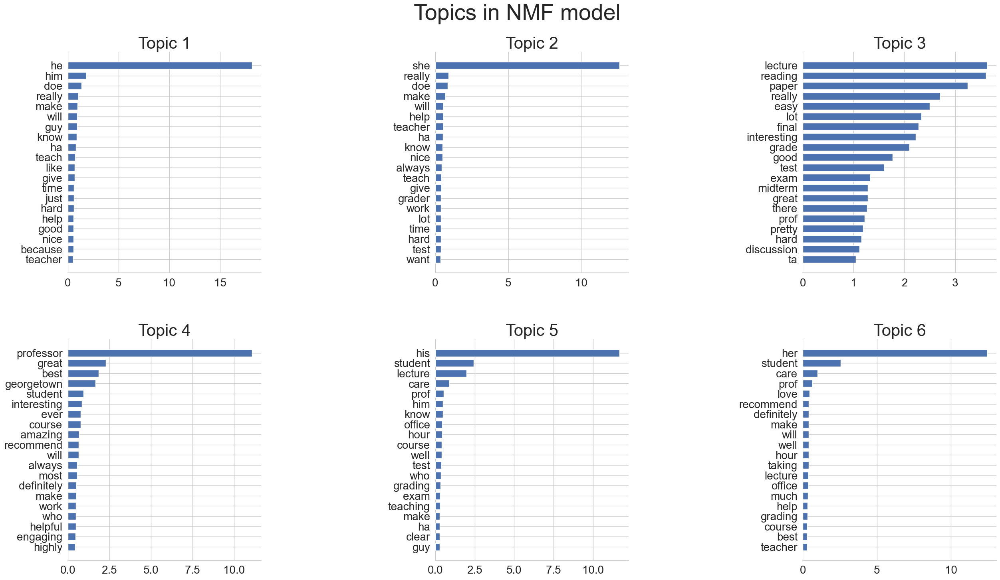

In [59]:
plot_top_words(nmf, feature_names, n_top_words, "Topics in NMF model")

In [60]:
# Uncomment for LDA model! It's much slower, and produces less interesting results
# imo, but for comparison you can uncomment and run to produce the same type of
# word-by-topic plot for the estimated LDA model:
# lda = LatentDirichletAllocation(
#     n_components=6,
#     random_state=5000,
# )
# lda.fit(X)
# plot_top_words(lda, cv_feature_names, n_top_words, "Topics in LDA model")

### (4.2) Removing Gender Terms

Basically, it looks like what's happening is that the gender signals are so strong that, despite us asking it to discover **6** topics in the corpus, **4 out of 6** of them are dominated by gendered pronouns like "he" or "she" as the most indicative word for that topic.

So, since we already knew this (the strength of the gender signal) from our previous exploration, let's **drop** the features corresponding to gendered pronouns and see what other signals it picks up in the absence of these words!

Here we run the same text-data-focused clustering models as before, but using `X_ng`, the **no-gender-pronouns** version of our matrix `X` that we created above.

In [61]:
#gender_indices = list(tf_feature_names.searchsorted(gender_tokens))
#gender_indices

In [62]:
nmf_ng = NMF(
    n_components=num_topics,
    random_state=5000,
    beta_loss="frobenius",
    max_iter=1000
)
nmf_ng.fit(X_ng)

NMF(max_iter=1000, n_components=6, random_state=5000)

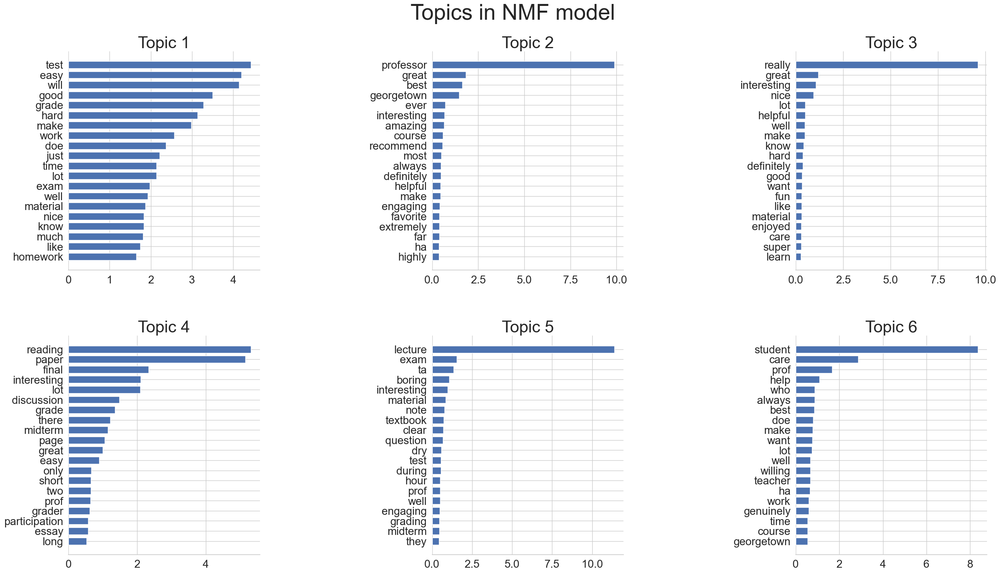

In [63]:
plot_top_words(nmf_ng, feature_names_ng, n_top_words, "Topics in NMF model")

And from these plots it looks like we have successfully removed the signal of **gender** (at least, the direct signal that was coming through the use of gendered pronouns), and in turn revealed some other dimensions/aspects of the data that weren't visible in our earlier plots. For example,

* **Topic 1** now seems to be about easiness/difficulty of grading, while
* **Topic 6** now seems to be about the care or the degree of helpfulness that the professors demonstrate with respect to student concerns

In [64]:
# Uncomment for LDA model, which takes longer than NMF!
# lda_nogender = LatentDirichletAllocation(
#     n_components=6,
#     random_state=5000,
# )
# lda_nogender.fit(X_nogender)
# cvnogend_feature_names = cv_nogender.get_feature_names_out()
# plot_top_words(lda_nogender, cvnogend_feature_names, n_top_words, "Topics in LDA model")

## (5) Visualizing Our Clusters in 2D via tSNE

In [65]:
from sklearn.manifold import TSNE

Here, by looking at the `.components_` matrix that the model outputs, we can see what Scikit-learn's `NMF` algorithm produces: a matrix where each **row** represents an inferred "topic", while each **column** represents a **feature**---in this case, a particular **word** from our vocabulary

In [66]:
nmf_ng_components = nmf_ng.components_
nmf_ng_components.shape

(6, 5149)

An important point here---a point which may seem confusing if you aren't careful to keep track of the **shape** of the matrices being inputted and the matrices being produced!---is that this `nmf_ng_components` object is **not** the object which would tell us what **topic** we should infer for each document in our corpus.

To obtain that information, we first need to **project** the full, original `X_ng` matrix **down** onto the **6 dimensions** we asked `NMF` to produce.

We can accomplish this by taking the estimated `NMF` object (called `nmf_ng` in this case) and using its `transform()` function to transform the **original** data into the **lower-dimensional** $N \times 6$ matrix that we desire (in the nomenclature of Non-Negative Matrix Factorization, we call the resulting matrix $W$):

In [67]:
W_nogender = nmf_ng.transform(X_ng)
W_nogender.shape

(29579, 6)

In [68]:
W_nogender[:5,:]

array([[0.02047745, 0.02684688, 0.        , 0.0251326 , 0.        ,
        0.0237446 ],
       [0.06384805, 0.        , 0.18847722, 0.16913168, 0.        ,
        0.        ],
       [0.02593246, 0.10935033, 0.11986294, 0.05621241, 0.        ,
        0.139945  ],
       [0.04298153, 0.        , 0.18027706, 0.15410906, 0.        ,
        0.        ],
       [0.02089768, 0.        , 0.00357336, 0.09093993, 0.00223421,
        0.01961415]])

In [69]:
W_nogender_df = pd.DataFrame(W_nogender)

In [70]:
# Find column with highest value for each document
W_nogender_df['cluster'] = W_nogender_df.idxmax(axis=1)

In [71]:
W_nogender_df['cluster'].value_counts()

cluster
1    6574
0    6300
3    5394
5    4349
2    3988
4    2974
Name: count, dtype: int64

In [72]:
W_nogender_df.head()

,0,1,2,3,4,5,cluster
0,0.020477,0.026847,0.000000,0.025133,0.000000,0.023745,1
1,0.063848,0.000000,0.188477,0.169132,0.000000,0.000000,2
2,0.025932,0.109350,0.119863,0.056212,0.000000,0.139945,5
3,0.042982,0.000000,0.180277,0.154109,0.000000,0.000000,2
4,0.020898,0.000000,0.003573,0.090940,0.002234,0.019614,3


In [73]:
tsne_model = TSNE(
    init='random',
    random_state=5000
)
tsne_embedding = tsne_model.fit_transform(W_nogender)
tsne_df = pd.DataFrame(tsne_embedding, columns=['x','y'])
tsne_df.shape

(29579, 2)

In [74]:
tsne_df.head()

,x,y
0,37.666908,-9.955474
1,-88.086662,-50.599281
2,-104.045250,-3.995506
3,-87.922073,-50.905193
4,21.295780,-44.652302


In [75]:
tsne_df['cluster'] = W_nogender_df['cluster']
tsne_df['review'] = reviews_df['comment']

In [76]:
tsne_df.head()

,x,y,cluster,review
0,37.666908,-9.955474,1,I took two classes with Wickham-Crowley this p...
1,-88.086662,-50.599281,2,Took her for Lit 1. Really really terribly org...
2,-104.045250,-3.995506,5,Professor Wickham-Crowley is great! She's real...
3,-87.922073,-50.905193,2,She teaches Lit His I frequently and while she...
4,21.295780,-44.652302,3,Prof wickham-Crowley is awesome. Lots of readi...


In [77]:
# Sample N points from the full DataFrame, so that the plot is manageable
tsne_sample_size = 300
tsne_sample_df = tsne_df.sample(tsne_sample_size, random_state=5000)

Here we can produce a scatterplot of the clustered points:

<Axes: xlabel='x', ylabel='y'>

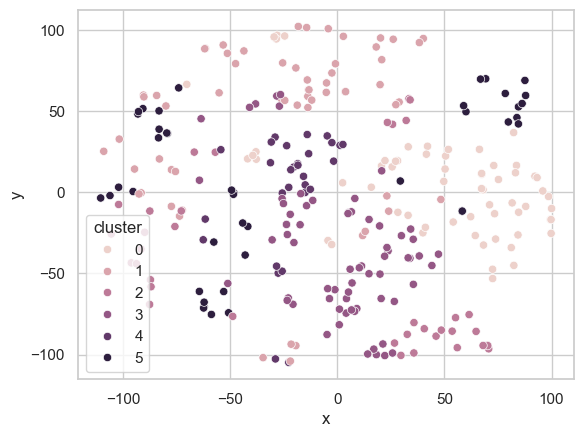

In [78]:
sns.scatterplot(tsne_sample_df, x='x', y='y', hue='cluster')

But, this visualization on its own is not very interesting or informative, because we don't actually know what the **text** of each plotted review looks like! For that, let's make an **interactive** plot using Plotly, which will allow us to hover over each point to display a popup showing us the full text of the plotted review:

In [79]:
import textwrap
mywrap = lambda x: textwrap.wrap(x, width=60)

In [80]:
tsne_sample_df.shape

(300, 4)

In [81]:
tsne_sample_df['review'] = tsne_sample_df['review'].apply(lambda x: x if type(x) == str else '')

In [82]:
tsne_sample_df['review_wrap'] = tsne_sample_df['review'].apply(lambda x: '<br>'.join(mywrap(x)))

In [83]:
import plotly.express as px

In [84]:
review_fig = px.scatter(tsne_sample_df, x='x', y='y', color='cluster',
                        hover_data=['review_wrap'], template='simple_white')
# Remove the colorbar
review_fig.update(layout_coloraxis_showscale=False)
# Make the points larger
review_fig.update_traces(marker=dict(size=12),selector=dict(mode='markers'))
review_fig.show()

## (6) Visualizing Our Clusters in 3D via Tensorboard Projector

If you find that this two-dimensional plot (and this restriction to only 250 sampled points) doesn't provide enough insight, you can also use the Tensorboard Projector from the `tensorflow` Jupyter extension to create interactive **3D** visualizations of your points!

Most of the Tensorboard Projector's methods limit us to 5000 points (still better than 250!), so we will randomly sample just 5K our ~30K points, but technically you could run it and still use some of the available visualizations like PCA which do **not** have a 5K-point maximum.

Unfortunately, the 3D visualization power that this provides is somewhat offset by the fact that it is difficult to import the **text of the reviews** into the 3D visualizer: it is possible, and if you end up wanting to use the Tensorboard Projector to visualize full-on text data with full-text previews please let me know (I will provide you with the messy, even-more-hackish version of this code), but for the sake of trying out the Projector without crashing, here I am producing visualizations of **just** the points along with their assigned clusters. By looking at the **id** value for each point in the 3D visualization, however, you can use an additional Python code cell in the notebook to check the full text for any desired point.

In [85]:
%load_ext tensorboard

In [86]:
import tensorflow as tf
import os
from tensorboard.plugins import projector

In [87]:
W_ng_text_df = W_nogender_df

In [88]:
W_tf_sample_df = W_nogender_df.sample(5000, random_state=5000)
W_tf_sample_df.shape

(5000, 7)

In [89]:
W_tf_sample_df.head()

,0,1,2,3,4,5,cluster
29384,0.107582,0.000095,0.0,0.000000,0.002773,0.003825,0
29321,0.060897,0.000000,0.0,0.000000,0.097887,0.000000,4
11540,0.027355,0.001776,0.0,0.000000,0.090168,0.132321,5
16135,0.118731,0.008752,0.0,0.089549,0.000000,0.000000,0
12766,0.085246,0.007238,0.0,0.000000,0.000000,0.005304,0


In [90]:
cluster_labels = W_tf_sample_df['cluster'].values
cluster_labels.shape

(5000,)

In [91]:
# Some initial code which is the same for all the variants
import os
import shutil
import numpy as np
import tensorflow as tf
from tensorboard.plugins import projector

def register_embedding(embedding_tensor_name, meta_data_fname, log_dir):
    config = projector.ProjectorConfig()
    embedding = config.embeddings.add()
    embedding.tensor_name = embedding_tensor_name
    embedding.metadata_path = meta_data_fname
    projector.visualize_embeddings(log_dir, config)

def save_labels_tsv(labels, filepath, log_dir):
    with open(os.path.join(log_dir, filepath), 'w') as f:
        for label in labels:
            f.write('{}\n'.format(label))

LOG_DIR = 'tmp'  # Tensorboard log dir
if not os.path.isdir(LOG_DIR):
  os.mkdir(LOG_DIR)
else:
  shutil.rmtree(LOG_DIR)
  os.mkdir(LOG_DIR)
META_DATA_FNAME = 'meta.tsv'  # Labels will be stored here
EMBEDDINGS_TENSOR_NAME = 'embeddings'
EMBEDDINGS_FPATH = os.path.join(LOG_DIR, EMBEDDINGS_TENSOR_NAME + '.ckpt')
STEP = 0

register_embedding(EMBEDDINGS_TENSOR_NAME, META_DATA_FNAME, LOG_DIR)
save_labels_tsv(cluster_labels, META_DATA_FNAME, LOG_DIR)

In [92]:
doc_embeddings = W_tf_sample_df.drop(columns=['cluster']).values
doc_embeddings.shape

(5000, 6)

In [93]:
# Size of files created on disk: 163kB
tf.compat.v1.disable_eager_execution()
tensor_embeddings = tf.Variable(doc_embeddings, name=EMBEDDINGS_TENSOR_NAME)
sess = tf.compat.v1.InteractiveSession()
sess.run(tf.compat.v1.global_variables_initializer())
saver = tf.compat.v1.train.Saver()
saver.save(sess, EMBEDDINGS_FPATH, STEP)
sess.close()

2023-10-29 22:48:00.999609: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:382] MLIR V1 optimization pass is not enabled


Here, again to prevent crashing (in your browser), I am just including the Tensorboard Projector instance running on my own server. But, the **Appendix** immediately after the `<iframe>` below contains exactly the code cells that I used to launch this `<iframe>`-embedded instance, so that you can **run this notebook in Colab** and uncomment the code in the Appendix to run within your own Colab runtime:

```{=html}
<iframe src="https://jjacobs.info/dsan5000-scratch/tensorboard_clusters.html" width="100%" height="800"></iframe>
```

## (Appendix) Running Tensorboard Projector Locally

In [1]:
# Use this to kill the Tensorboard Projector process, if it freezes for example
#!kill 75653

Uncommenting and running the code in the following cell should cause a Tensorboard Projector interface to pop up within the output of the cell, but (frustratingly) you'll usually have to **run it *twice***, since (because of hard-to-explain Tensorflow weirdness) it will not correctly detect the `./tmp` directory created above the first time it is run :/

In [2]:
#%tensorboard --logdir tmp

If you accidentally delete the `%tensorboard --logdir tmp` line, for example, or if you just want to see how to control the underlying Tensorboard server directly within the notebook: the following cell will print out the **port number** for all running instances of Tensorboard

In [103]:
from tensorboard import notebook
notebook.list() # View open TensorBoard instances

Known TensorBoard instances:
  - port 6006: logdir tmp (started 0:00:19 ago; pid 75674)


So that, for example, you could **switch between** different instances within the same notebook, by changing the `port` argument in the call to `notebook.display()` below:

In [3]:
#notebook.display(port=6006, height=800)